In [141]:
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from scipy.spatial.distance import cosine, euclidean, cityblock, canberra, braycurtis
import warnings
warnings.filterwarnings("ignore")

import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

In [142]:
data = pd.read_csv("data.csv")
genre_data = pd.read_csv('data_by_genres.csv')
year_data = pd.read_csv('data_by_year.csv')

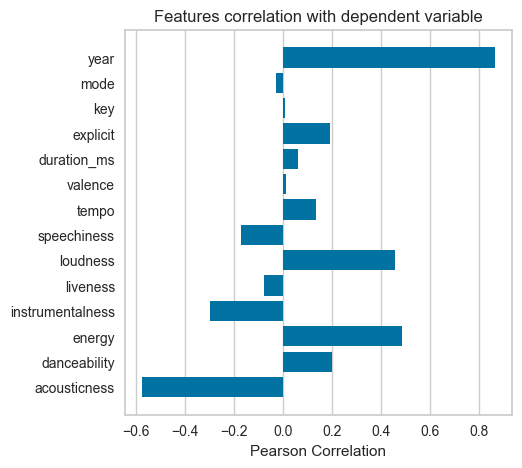

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [143]:

from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo', 'valence', 'duration_ms', 'explicit', 'key', 'mode', 'year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize'] = (5, 5)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

In [144]:
cluster_pipeline = Pipeline(
    [('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [145]:
tsne_pipeline = Pipeline(
    [('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])

fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.008s...
[t-SNE] Computed neighbors for 2973 samples in 0.187s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106300
[t-SNE] KL divergence after 1000 iterations: 1.394133


In [146]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()),('kmeans', KMeans(n_clusters=20, verbose=False))], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [147]:
pca_pipeline = Pipeline([('scaler', StandardScaler()),
                        ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

In [148]:


clientId = '114445a5b03f4ad9839ee3bb4b2d56ce'
clientSecret = 'e6ae322b1c8c4963bdb2dbb3cad9bf77'
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(
    client_id=clientId, client_secret=clientSecret))


def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q='track: {} year: {}'.format(name, year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [149]:
def get_song_data(song, spotify_data):
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) & (spotify_data['year'] == song['year'])].iloc[0]
        print('Fetching song information from local dataset')
        return song_data

    except IndexError:
        print('Fetching song information from spotify dataset')
        return find_song(song['name'], song['year'])


def get_mean_vector(song_list, spotify_data):
    song_vectors = []
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)

    # nd-array where n is number of songs in list. It contains all numerical vals of songs in sep list.
    song_matrix = np.array(list(song_vectors))
    # print(f'song_matrix {song_matrix}')
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []  # 'name', 'year'
    for dic in dict_list:
        for key, value in dic.items():
            flattened_dict[key].append(value)  # creating list of values
    return flattened_dict

In [167]:
def recommend_songs(song_list, spotify_data, dist_algo=None, super_like=None, n_songs=10):
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)

    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))

    n = len(scaled_data)
    feature = len(scaled_data[0])
    distances = np.empty([1, n])
    weight = np.ones(feature)

    if super_like != None and isinstance(super_like, list):
        for like in super_like:
            weight[like-1] = 2
    else:
        raise ValueError('Argument super_like must be a list')

    if dist_algo == None:
        raise ValueError('You must enter a distance algorithm')
    elif dist_algo == 'cosine':
        for i in range(n):
            distances[0][i] = cosine(scaled_song_center[0], scaled_data[i], w=weight)
    elif dist_algo == 'euclidean':
        for i in range(n):
            distances[0][i] = euclidean(scaled_song_center[0], scaled_data[i], w=weight)
    elif dist_algo == 'cityblock':
        for i in range(n):
            distances[0][i] = cityblock(scaled_song_center[0], scaled_data[i], w=weight)
    elif dist_algo == 'braycurtis':
        for i in range(n):
            distances[0][i] == braycurtis(scaled_song_center[0], scaled_data[i], w=weight)
    elif dist_algo == 'canberra':
        for i in range(n):
            distances[0][i] == canberra(scaled_song_center[0], scaled_data[i], w=weight)
    else:
        raise ValueError(f'Your distance algorithm "{dist_algo}" is invalid')
    






    




    # for target in scaled_data:
    #     distances.append(scipy.spatial.distance.cosine(scaled_song_center[0], target))

    # distances = scipy.spatial.distance.cosine(scaled_song_center[0], scaled_data[0])
    # distances = pairwise_distances(
    #     scaled_song_center, scaled_data, metric=dist_algo)
    # print(distances.shape)
    index = list(np.argsort(distances)[:, :n_songs][0])

    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

In [171]:
recommend_songs([{'name': 'Hotel Ceiling', 'year': 2014}], data, dist_algo="cosine", super_like=[2])

Fetching song information from local dataset


[{'name': 'Gabrielle', 'year': 2020, 'artists': "['Brett Eldredge']"},
 {'name': 'We Go Together Like', 'year': 2020, 'artists': "['Abby Anderson']"},
 {'name': 'Wonder Woman', 'year': 2018, 'artists': "['Kacey Musgraves']"},
 {'name': 'Crazy for You', 'year': 2009, 'artists': "['Madonna']"},
 {'name': 'Back Home', 'year': 2014, 'artists': "['Andy Grammer']"},
 {'name': 'Good Die Young', 'year': 2020, 'artists': "['Koe Wetzel']"},
 {'name': 'Dark Days', 'year': 2016, 'artists': "['Local Natives']"},
 {'name': 'Saltwater Gospel', 'year': 2017, 'artists': "['Eli Young Band']"},
 {'name': 'Sangria', 'year': 2014, 'artists': "['Blake Shelton']"}]

# Cosine

In [157]:
recommend_songs([{'name': 'Hotel Ceiling', 'year': 2014}], data, dist_algo="cosine")

Fetching song information from local dataset


[{'name': 'Gabrielle', 'year': 2020, 'artists': "['Brett Eldredge']"},
 {'name': 'We Go Together Like', 'year': 2020, 'artists': "['Abby Anderson']"},
 {'name': 'Crazy for You', 'year': 2009, 'artists': "['Madonna']"},
 {'name': 'Back Home', 'year': 2014, 'artists': "['Andy Grammer']"},
 {'name': 'Wonder Woman', 'year': 2018, 'artists': "['Kacey Musgraves']"},
 {'name': 'Good Die Young', 'year': 2020, 'artists': "['Koe Wetzel']"},
 {'name': 'Dark Days', 'year': 2016, 'artists': "['Local Natives']"},
 {'name': 'El Amor', 'year': 2009, 'artists': '[\'Tito "El Bambino"\']'},
 {'name': 'Saltwater Gospel', 'year': 2017, 'artists': "['Eli Young Band']"}]

# Euclidean

In [152]:
recommend_songs([{'name': 'Hotel Ceiling', 'year': 2014}], data, dist_algo="euclidean")

Fetching song information from local dataset


[{'name': 'Crazy for You', 'year': 2009, 'artists': "['Madonna']"},
 {'name': 'Dark Days', 'year': 2016, 'artists': "['Local Natives']"},
 {'name': 'Gabrielle', 'year': 2020, 'artists': "['Brett Eldredge']"},
 {'name': 'Wonder Woman', 'year': 2018, 'artists': "['Kacey Musgraves']"},
 {'name': 'El Amor', 'year': 2009, 'artists': '[\'Tito "El Bambino"\']'},
 {'name': 'Sangria', 'year': 2014, 'artists': "['Blake Shelton']"},
 {'name': 'I Believe in You', 'year': 2016, 'artists': "['Michael Bublé']"},
 {'name': 'Back Home', 'year': 2014, 'artists': "['Andy Grammer']"},
 {'name': 'Saltwater Gospel', 'year': 2017, 'artists': "['Eli Young Band']"}]

# Manhattan

In [153]:
recommend_songs([{'name': 'Hotel Ceiling', 'year': 2014}], data, dist_algo="manhattan")

Fetching song information from local dataset


[{'name': 'Crazy for You', 'year': 2009, 'artists': "['Madonna']"},
 {'name': 'Dark Days', 'year': 2016, 'artists': "['Local Natives']"},
 {'name': 'Gabrielle', 'year': 2020, 'artists': "['Brett Eldredge']"},
 {'name': 'Wonder Woman', 'year': 2018, 'artists': "['Kacey Musgraves']"},
 {'name': 'El Amor', 'year': 2009, 'artists': '[\'Tito "El Bambino"\']'},
 {'name': 'Sangria', 'year': 2014, 'artists': "['Blake Shelton']"},
 {'name': 'I Believe in You', 'year': 2016, 'artists': "['Michael Bublé']"},
 {'name': 'Back Home', 'year': 2014, 'artists': "['Andy Grammer']"},
 {'name': 'Saltwater Gospel', 'year': 2017, 'artists': "['Eli Young Band']"}]

# Braycurtis

In [154]:
recommend_songs([{'name': 'Hotel Ceiling', 'year': 2014}], data, dist_algo="braycurtis")

Fetching song information from local dataset


[{'name': 'Crazy for You', 'year': 2009, 'artists': "['Madonna']"},
 {'name': 'Dark Days', 'year': 2016, 'artists': "['Local Natives']"},
 {'name': 'Gabrielle', 'year': 2020, 'artists': "['Brett Eldredge']"},
 {'name': 'Wonder Woman', 'year': 2018, 'artists': "['Kacey Musgraves']"},
 {'name': 'El Amor', 'year': 2009, 'artists': '[\'Tito "El Bambino"\']'},
 {'name': 'Sangria', 'year': 2014, 'artists': "['Blake Shelton']"},
 {'name': 'I Believe in You', 'year': 2016, 'artists': "['Michael Bublé']"},
 {'name': 'Back Home', 'year': 2014, 'artists': "['Andy Grammer']"},
 {'name': 'Saltwater Gospel', 'year': 2017, 'artists': "['Eli Young Band']"}]

# Canberra

In [155]:
recommend_songs([{'name': 'Hotel Ceiling', 'year': 2014}], data, dist_algo="canberra")

Fetching song information from local dataset


[{'name': 'The Calling',
  'year': 2016,
  'artists': "['TheFatRat', 'Laura Brehm']"},
 {'name': 'Mejor Me Voy',
  'year': 2006,
  'artists': "['La Nobleza De Aguililla']"},
 {'name': "Highway Headin' South",
  'year': 1974,
  'artists': "['Dolly Parton']"},
 {'name': 'Tampaxaniotikos', 'year': 1940, 'artists': "['Kostas Roukounas']"},
 {'name': "We're Gonna Hold On",
  'year': 1999,
  'artists': "['George Jones', 'Tammy Wynette']"},
 {'name': 'Just in Case - Remastered Version',
  'year': 1960,
  'artists': "['The Everly Brothers']"},
 {'name': 'You Better Believe',
  'year': 1957,
  'artists': "['Gene Vincent & His Blue Caps']"},
 {'name': 'A Little Bit of Abuse', 'year': 1981, 'artists': "['The Kinks']"},
 {'name': 'Solo (feat. Demi Lovato)',
  'year': 2018,
  'artists': "['Clean Bandit', 'Demi Lovato']"},
 {'name': 'Meanstreak', 'year': 1988, 'artists': "['AC/DC']"}]